In [1]:
import h5py
import numpy as np
import pandas as pd

In [2]:
direc='/data/cme_sims/LEVEL0/DOICMEM_00001'
f1=direc+'/DOICMEM_00001.h5'
f2=direc+'/DOICMEM_00001_1D.h5'
f3=direc+'/DOICMEM_00001_Shell.h5'

In [3]:

timeMag=[0 for i in range(0,108)]
def visualizeradial(filename):
    dataset = h5py.File(filename, 'r')
#     print(dataset.keys())
    for n in dataset.keys():
        if n=='X':
            break
        step=dataset[n]
        
        n=int(n.rsplit("#", 1)[-1])
        print(n)
        
        Bxvalues = list(step['Bx'])        
        Byvalues = list(step['By'])
        Bzvalues = list(step['Bz'])       

        data = pd.DataFrame({"Bx": Bxvalues, "By": Byvalues, "Bz": Bzvalues})
    
        data.columns = ["Bx","By","Bz"]
        mag = [[0 for j in range(256)] for i in range(256)]
        for i in range(0,256):
            for j in range(0,256):
                ##magnitude of magnetic field
                dx=data['Bx'][i][63][j]
                dy=data['By'][i][63][j]
                dz=data['Bz'][i][63][j]
                mag[i][j]=np.sqrt(dx**2 + dy**2 + dz**2)
  
        timeMag[n]=np.array(mag)
        

In [4]:
visualizeradial(f1)

10
100
101
102
103
104
105
106
107
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
5
50
51
52
53
54
55
56
57
58
59
6
60
61
62
63
64
65
66
67
68
69
7
70
71
72
73
74
75
76
77
78
79
8
80
81
82
83
84
85
86
87
88
89
9
90
91
92
93
94
95
96
97
98
99


In [ ]:
timeMag[5].max()

In [5]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

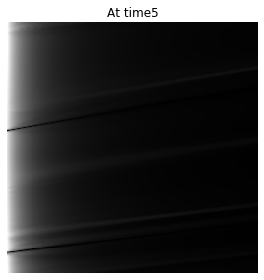

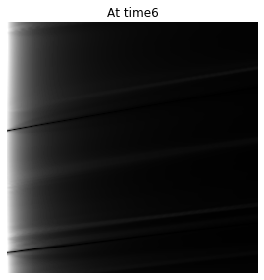

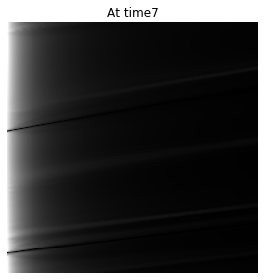

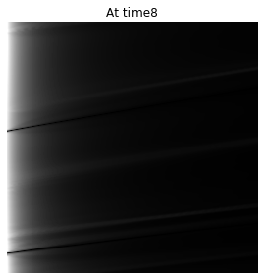

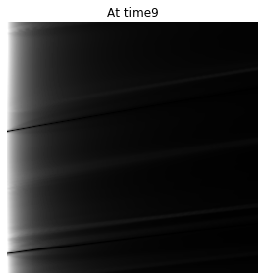

...

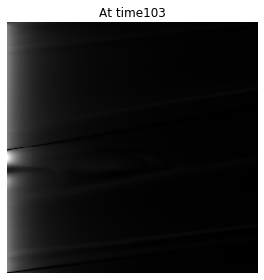

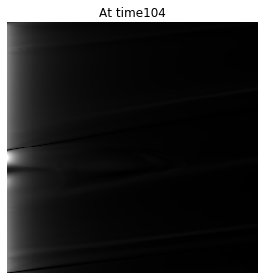

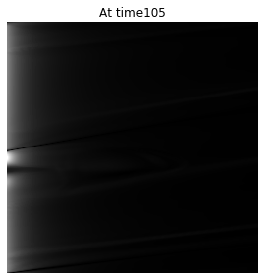

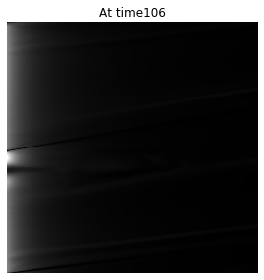

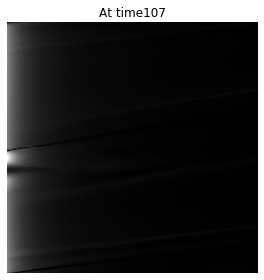

In [18]:
def plotter0():
    for n in range(5,108):    
        ##plotting magnitudes
        plt.imshow(timeMag[n], interpolation='none',cmap='gray')
        plt.title('At time'+str(n))
        path = 'plots/'
        filename = str(n)+'.png'
        plt.axis('off')
# save the plot as an image in the specified folder
        plt.tight_layout()
        plt.savefig(path + filename,transparent=True)
        plt.show()
plotter0()

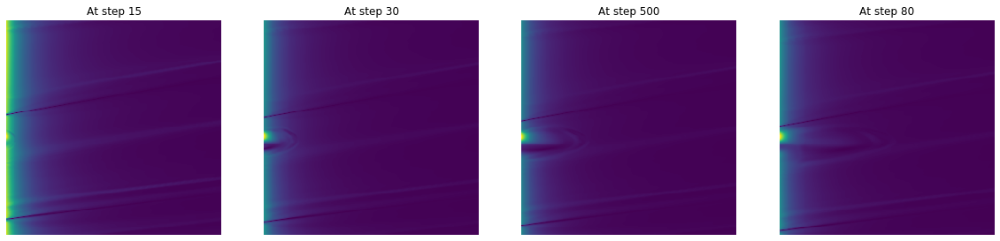

In [17]:
plt.figure(figsize=(20,20))
plt.subplot(2,4,1)
plt.imshow(timeMag[15])
plt.title("At step 15")
plt.axis("off")
plt.subplot(2,4,2)
plt.imshow(timeMag[30])
plt.axis("off")
plt.title("At step 30")
plt.subplot(2,4,3)
plt.imshow(timeMag[50])
plt.axis("off")
plt.title("At step 500")
plt.subplot(2,4,4)
plt.imshow(timeMag[80])

plt.axis("off")
plt.title("At step 80")
plt.show()

In [19]:
import imageio as imageio
filenames = [f'./plots/{i}.png' for i in range(5,107)]
with imageio.get_writer('gifs/mag.gif', mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

In [20]:
from moviepy.editor import VideoFileClip
# Load the GIF video
gif_video = VideoFileClip("gifs/mag.gif")
# Display the video
gif_video.ipython_display(loop=True, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


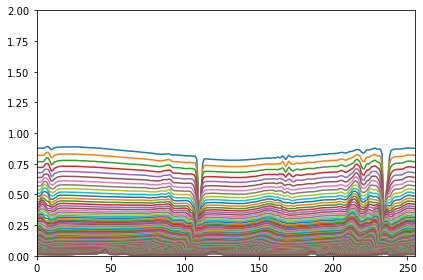

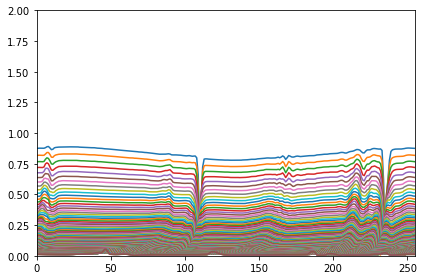

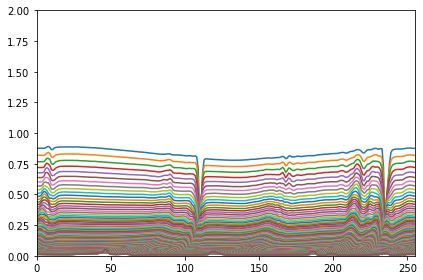

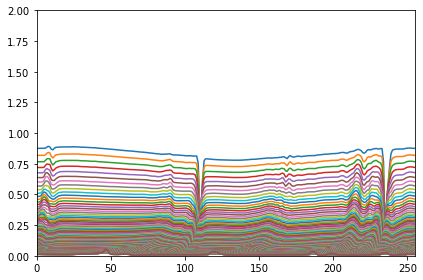

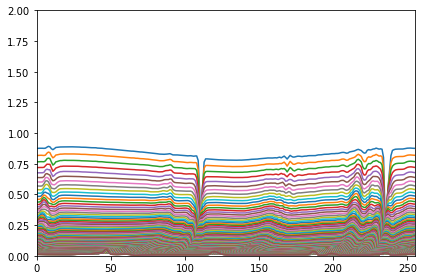

...

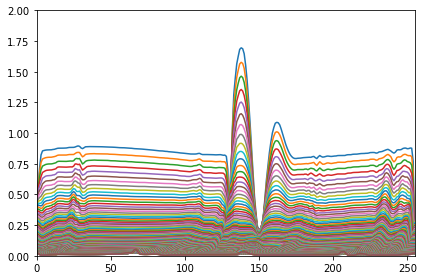

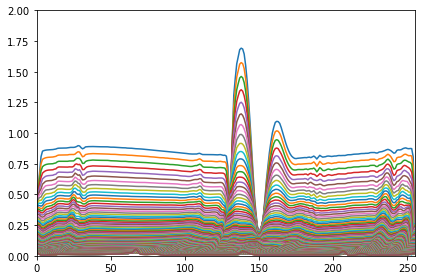

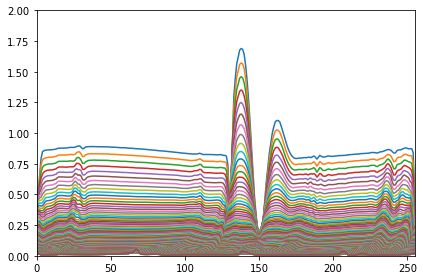

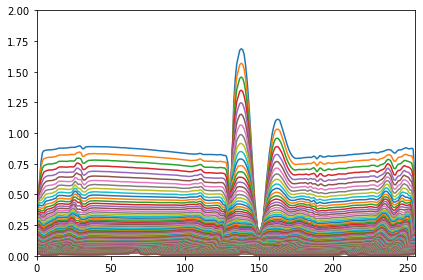

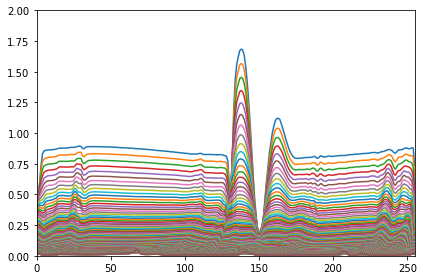

In [21]:
def plotter1():
    for n in range(5,108):    
        ##plotting magnitudes
       
        plt.plot(timeMag[n],label=n)
        path = '1_plots/'
        filename = str(n)+'.png'
        plt.ylim(0, 2)
        plt.xlim(0,255)
        plt.grid(False)
# save the plot as an image in the specified folder
        plt.tight_layout()
        plt.savefig(path + filename,transparent=True)
        plt.show()
plotter1()

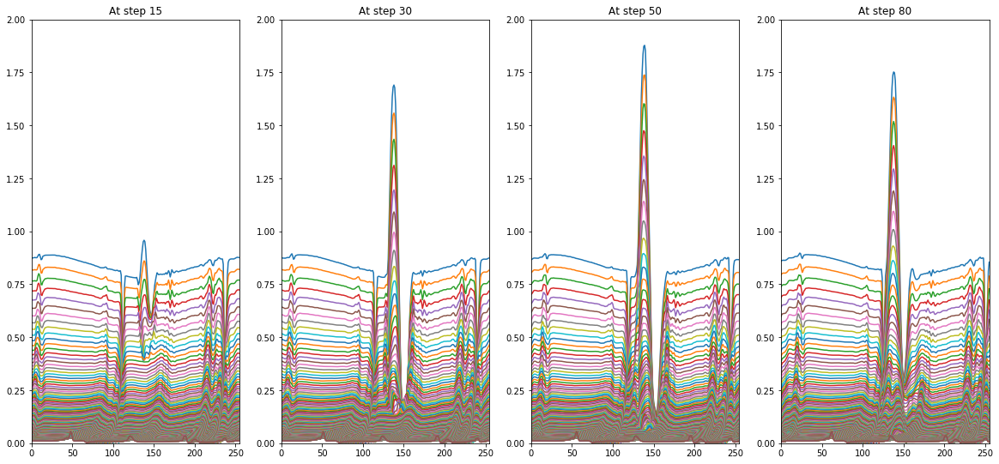

In [26]:
plt.figure(figsize=(20,20))

plt.subplot(2,4,1)
plt.plot(timeMag[15],label=15)
plt.ylim(0, 2)
plt.xlim(0,255)
plt.title("At step 15")
# plt.axis("off")
plt.subplot(2,4,2)
plt.plot(timeMag[30],label=30)
plt.ylim(0, 2)
plt.xlim(0,255)
# plt.axis("off")
plt.title("At step 30")
plt.subplot(2,4,3)
plt.plot(timeMag[50],label=50)
plt.ylim(0, 2)
plt.xlim(0,255)
# plt.axis("off")
plt.title("At step 50")
plt.subplot(2,4,4)
plt.plot(timeMag[80],label=80)
plt.ylim(0, 2)
plt.xlim(0,255)

# plt.axis("off")
plt.title("At step 80")
plt.show()

In [27]:
filenames = [f'./1_plots/{i}.png' for i in range(5,107)]
with imageio.get_writer('gifs/1_mag.gif', mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

In [28]:
# Load the GIF video
gif_video = VideoFileClip("gifs/1_mag.gif")

# Display the video
gif_video.ipython_display(loop=True, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


### Magnitude Difference Matrix calculation

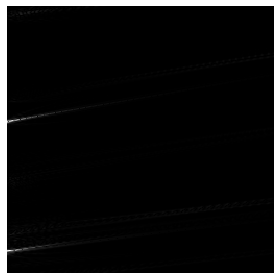

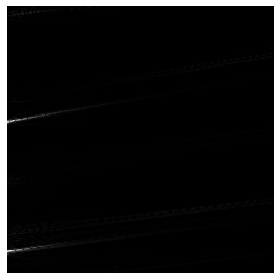

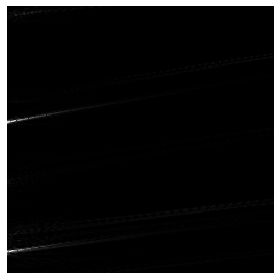

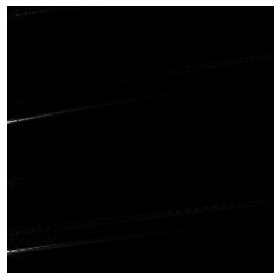

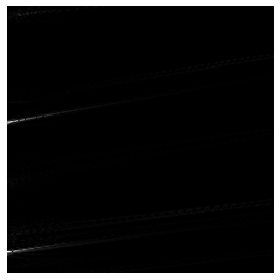

...

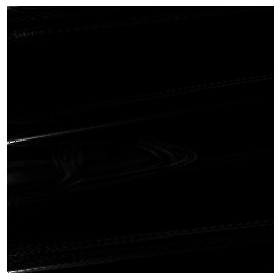

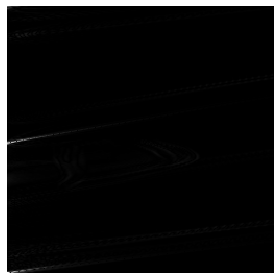

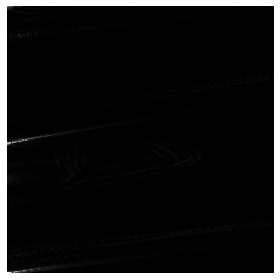

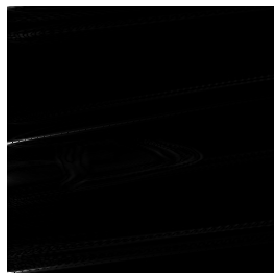

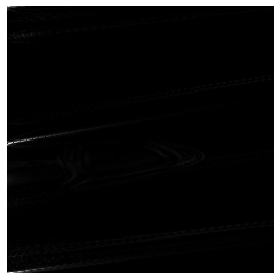

In [29]:
# differenceMat=[0 for i in range(107)]
differenceMat= [[[0 for k in range(128)] for j in range(256)] for i in range(107)]
def Matdifference():
    
    for i in range(5,107):
        if i==107:
            break
#         differenceMat[i]=np.around(timeMag[i],decimals=5,out=None)-np.around(timeMag[i+1],decimals=5,out=None)
        differenceMat[i]=abs(np.array(timeMag[i])-np.array(timeMag[i+1]))
        thresh=(np.min(differenceMat[i])*10)
        for j in range(256):
            for k in range(128):
                if differenceMat[i][j][k]<thresh:
                    differenceMat[i][j][k]=0
                    
#         print("Difference between timesteps", i,i+1)
#         print(differenceMat[i])
#     print(differenceMat)
        plt.axis("off")
        plt.imshow(differenceMat[i], interpolation='none',cmap='gray')
        path = 'difplots/'
        filename = str(i)+'.png'
        
# save the plot as an image in the specified folder
        plt.tight_layout()
        plt.savefig(path + filename, transparent=True,bbox_inches='tight')
        plt.show()
Matdifference()


In [30]:
differenceMat[5]

array([[1.98865040e-04, 1.64564610e-04, 3.44681338e-06, ...,
        2.03689828e-05, 2.36939194e-05, 2.50825648e-05],
       [3.44153328e-04, 2.76346562e-04, 1.56678616e-04, ...,
        5.74474278e-05, 6.30178965e-05, 5.75356827e-05],
       [1.32448357e-04, 1.29429347e-04, 1.44371753e-04, ...,
        5.12065749e-05, 4.48670799e-05, 3.72978531e-05],
       ...,
       [1.56764394e-04, 8.76730838e-06, 2.99964983e-04, ...,
        2.82115512e-06, 6.04281744e-06, 8.69899836e-06],
       [5.24648442e-05, 2.12126294e-04, 2.39770426e-04, ...,
        4.71281346e-06, 7.26038318e-06, 7.48180797e-06],
       [3.14370803e-05, 3.65083696e-05, 3.55424099e-05, ...,
        3.36871602e-06, 2.69879162e-06, 1.27275211e-06]])

In [31]:
filenames1 = [f'./difplots/{i}.png' for i in range(5,106)]
with imageio.get_writer('gifs/diff.gif', mode='I') as writer:
    for filename in filenames1:
        image = imageio.imread(filename)
        writer.append_data(image)
# Load the GIF video
gif_video = VideoFileClip("gifs/diff.gif")

# Display the video
gif_video.ipython_display(loop=True, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


### Thresholding, finding contours using convex hull to observe the polygons where CME is focussed

5.png


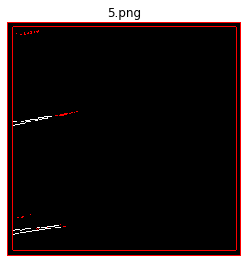

6.png


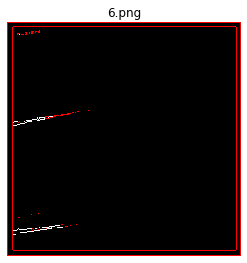

7.png


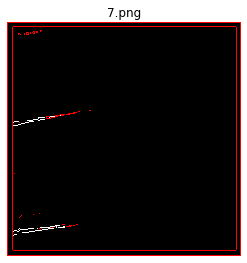

8.png


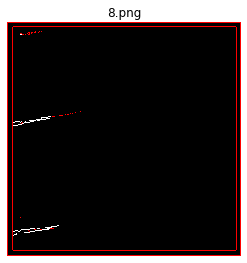

9.png


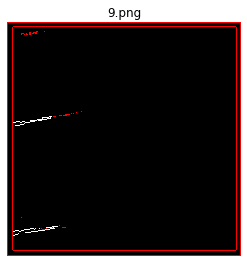

10.png


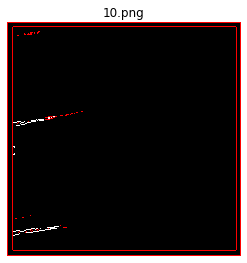

11.png


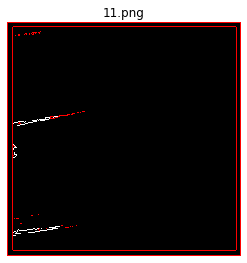

12.png


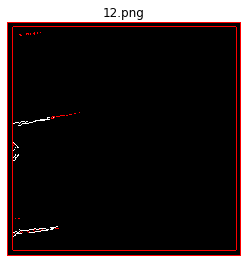

13.png


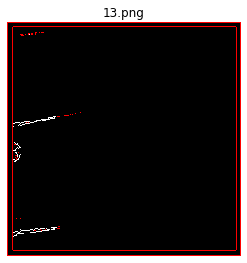

14.png


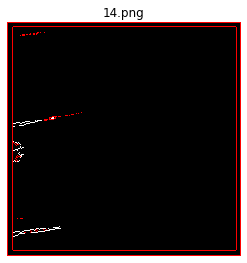

15.png


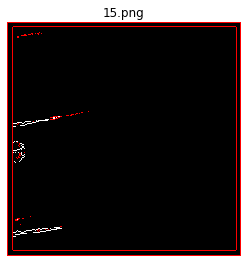

16.png


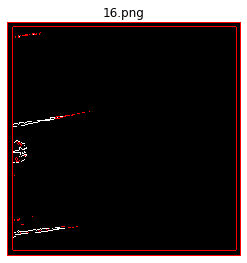

17.png


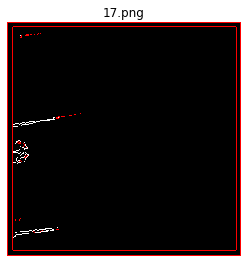

18.png


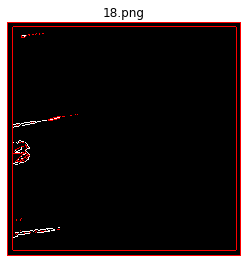

19.png


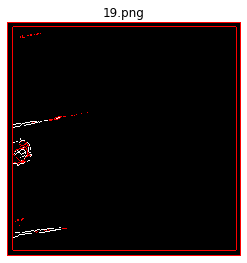

20.png


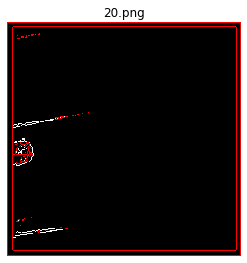

21.png


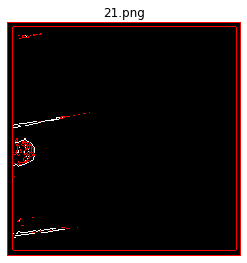

22.png


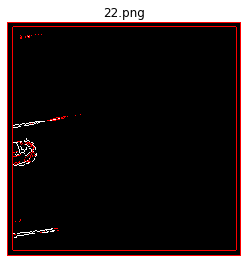

23.png


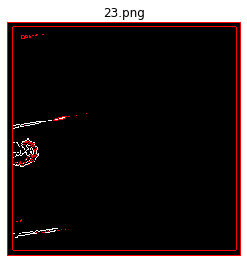

24.png


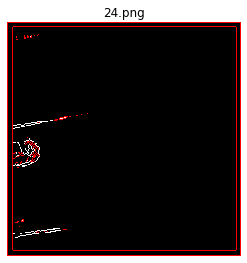

25.png


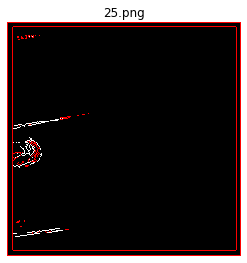

26.png


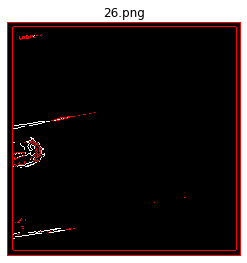

27.png


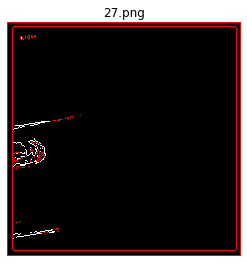

28.png


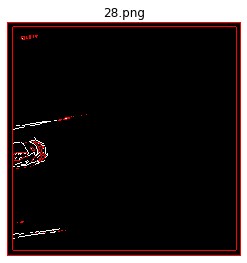

29.png


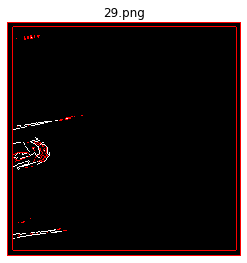

30.png


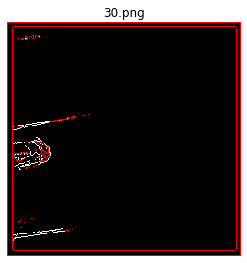

31.png


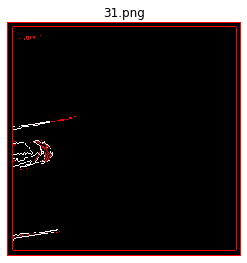

32.png


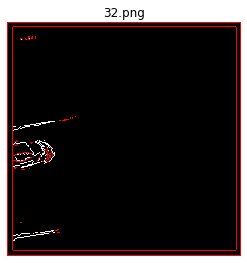

33.png


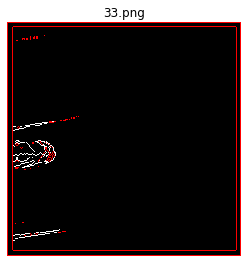

34.png


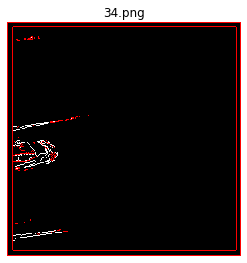

35.png


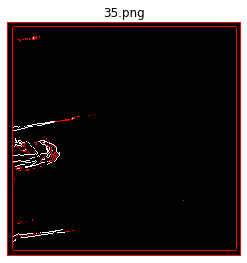

36.png


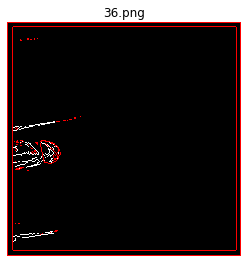

37.png


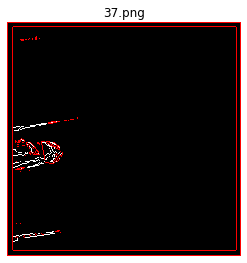

38.png


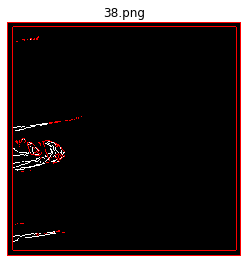

39.png


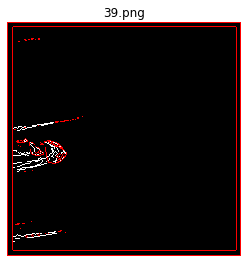

40.png


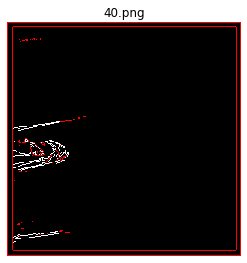

41.png


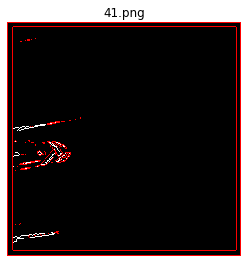

42.png


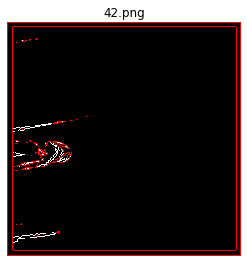

43.png


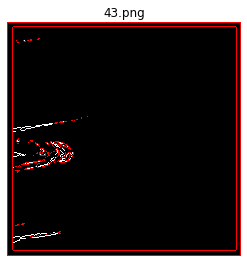

44.png


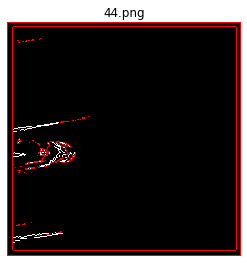

45.png


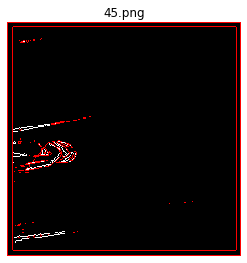

46.png


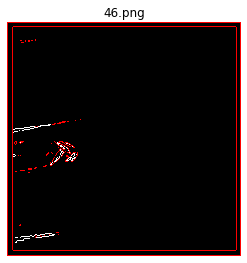

47.png


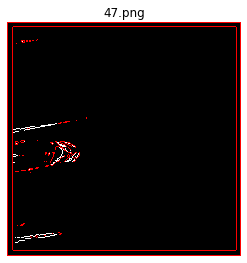

48.png


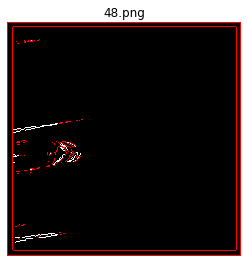

49.png


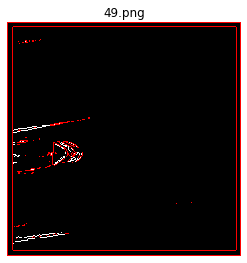

50.png


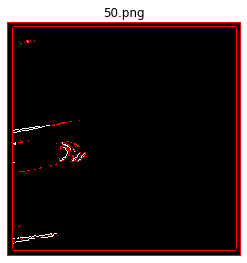

51.png


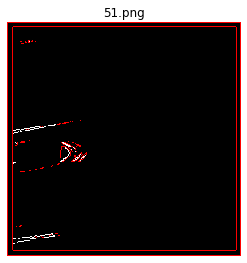

52.png


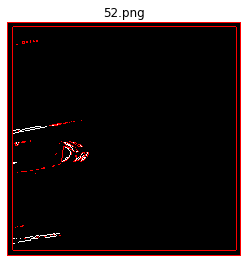

53.png


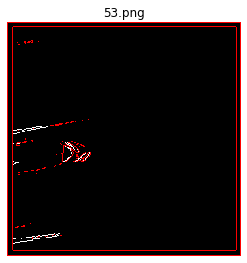

54.png


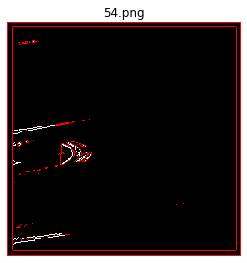

55.png


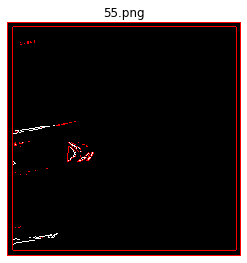

56.png


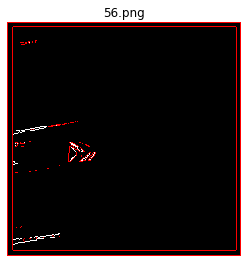

57.png


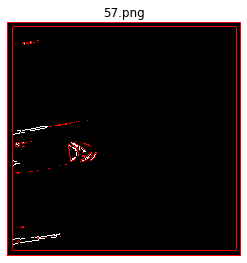

58.png


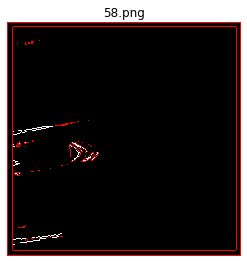

59.png


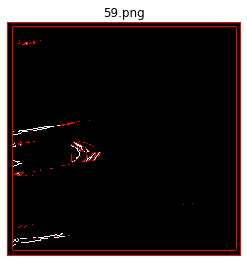

60.png


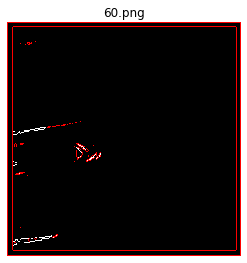

61.png


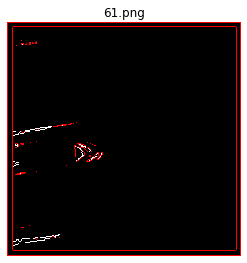

62.png


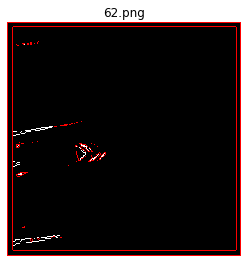

63.png


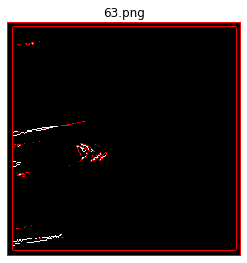

64.png


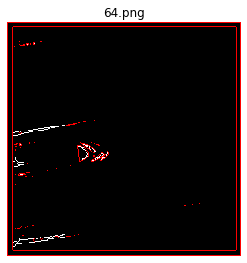

65.png


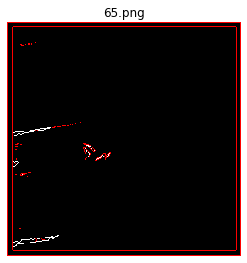

66.png


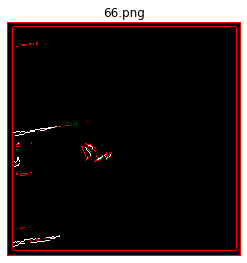

67.png


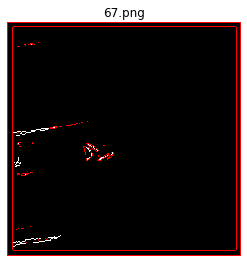

68.png


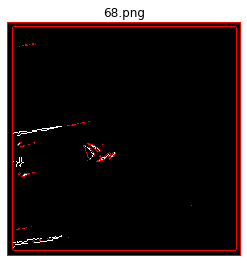

69.png


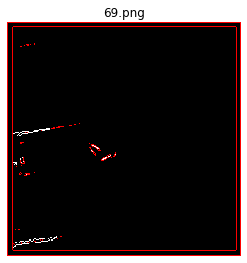

70.png


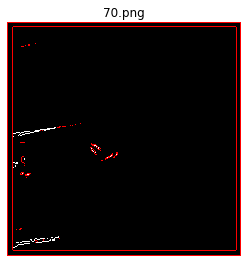

71.png


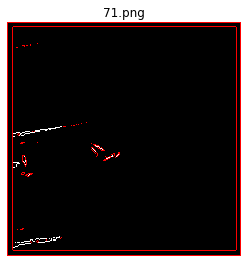

72.png


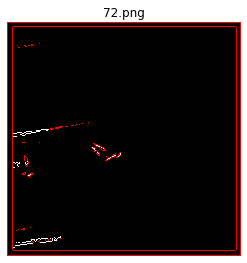

73.png


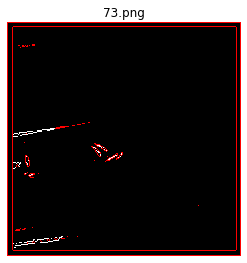

74.png


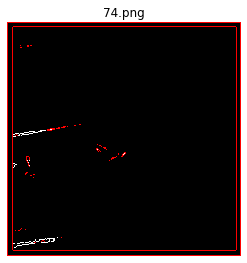

75.png


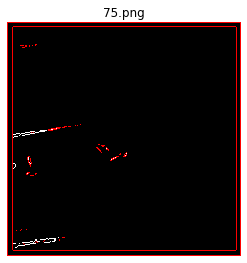

76.png


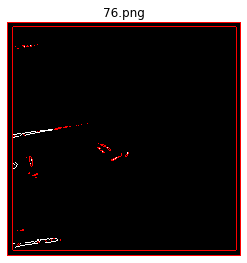

77.png


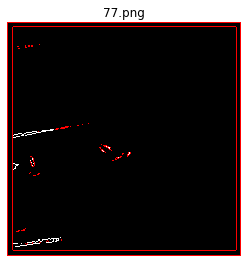

78.png


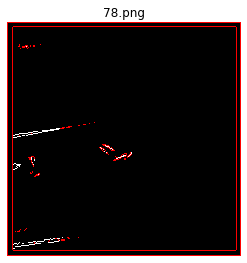

79.png


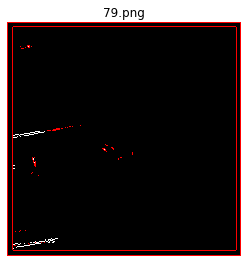

80.png


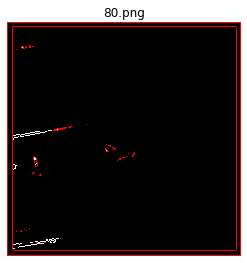

81.png


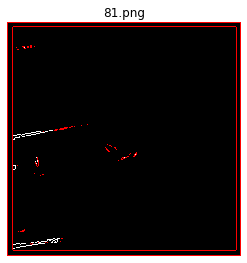

82.png


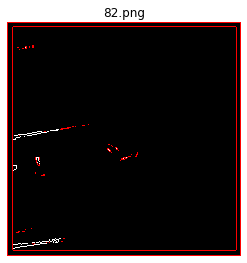

83.png


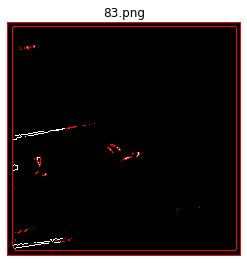

84.png


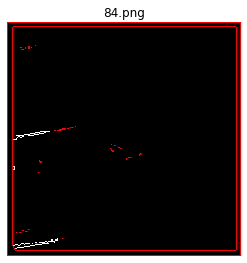

85.png


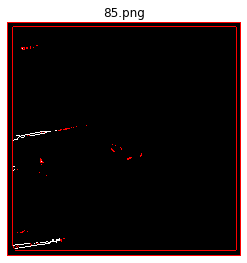

86.png


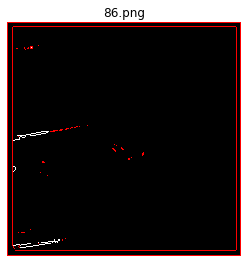

87.png


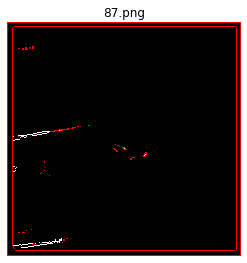

88.png


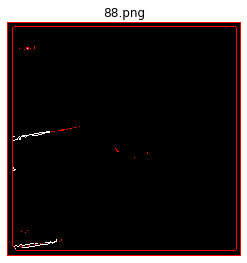

89.png


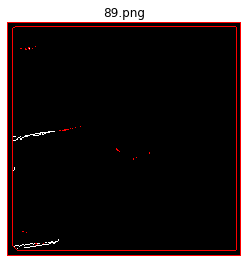

90.png


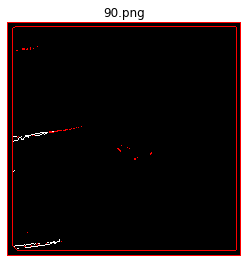

91.png


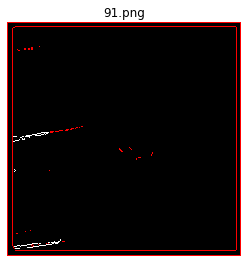

92.png


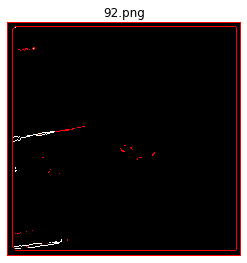

93.png


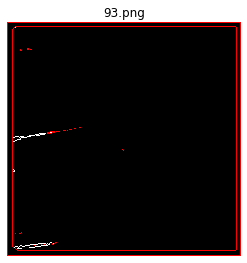

94.png


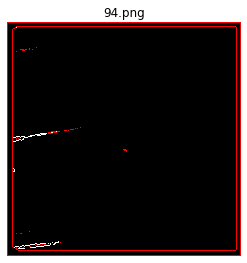

95.png


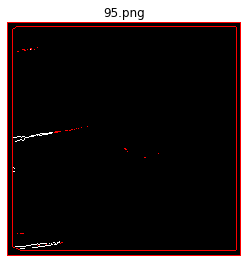

96.png


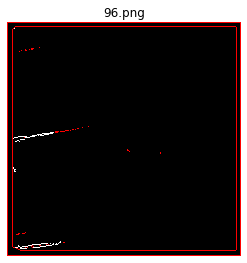

97.png


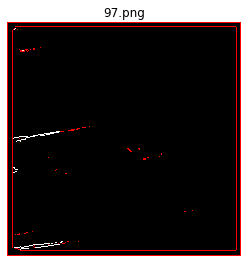

98.png


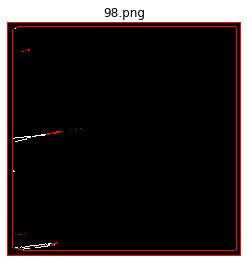

99.png


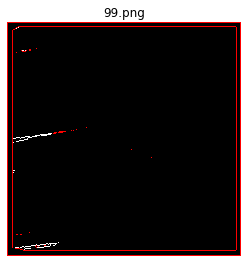

100.png


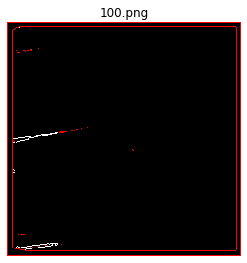

101.png


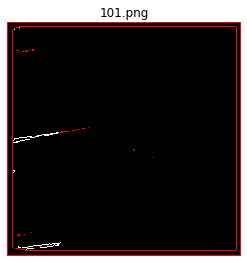

102.png


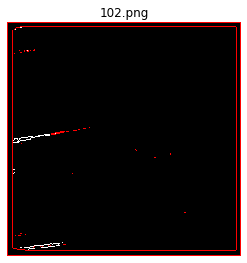

103.png


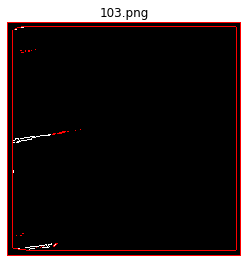

104.png


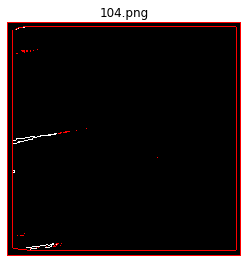

105.png


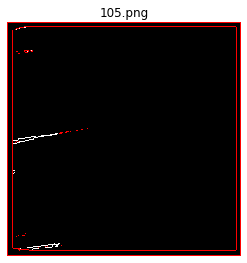

In [39]:
import cv2
from scipy import ndimage as ndi
from skimage.util import random_noise
from skimage import feature
def MatThresholding():
 
    for filename in filenames1:
        
        loaded_image = cv2.imread(filename)
        
#         edged_image = cv2.Canny(loaded_image, threshold1=70, threshold2=100)
#         blur_image = cv2.GaussianBlur(loaded_image, (3,3), 0) 
        ret, thresh = cv2.threshold(loaded_image, 15, 255, cv2.THRESH_BINARY)
        loaded_image = cv2.cvtColor(thresh,cv2.COLOR_BGR2RGB)
        gray_image = cv2.cvtColor(loaded_image,cv2.COLOR_BGR2GRAY)
#         plt.imshow(gray_image)
        
        contours, hierarchy = cv2.findContours(gray_image, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        # create hull array for convex hull points
        hull = []

        # calculate points for each contour
        for i in range(len(contours)):
            # creating convex hull object for each contour
            hull.append(cv2.convexHull(contours[i], False))
            
        # create an empty black image
        drawing = np.zeros((thresh.shape[0], thresh.shape[1], 3), np.uint8)
        
        # draw contours and hull points
        for i in range(len(contours)):
            color_contours = (255, 255, 255) #white - color for contours
            color = (255, 0, 0) #  red- color for convex hull
#             draw ith contour
            cv2.drawContours(drawing, contours, i, color_contours, 1, 8, hierarchy)
#             draw ith convex hull object
            cv2.drawContours(drawing, hull, i, color, 1, 8)
        
            plt.imshow(drawing)

        
#         pixels = np.argwhere(drawing== 254)
        
#             print(pixels)
        path = 'Threshplots/'
        file = filename.split('/')[2]
        print(file)
# save the plot as an image in the specified folder
        plt.savefig(path + file,transparent=True,bbox_inches='tight')
        plt.title(file)
        plt.tight_layout()
        plt.axis('off')
        
        plt.show()
MatThresholding()

In [35]:
files = [f'./Threshplots/{i}.png' for i in range(5,106)]
with imageio.get_writer('gifs/Threshdiff.gif', mode='I') as writer:
    for filename in files:
        image = imageio.imread(filename)
        writer.append_data(image)
# Load the GIF video
gif_video = VideoFileClip("gifs/Threshdiff.gif")

# Display the video
gif_video.ipython_display(loop=True, autoplay=True)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


TypeError: Image data of dtype <U18 cannot be converted to float

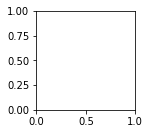

In [37]:
# plt.figure(figsize=(20,20))
# plt.subplot(2,4,1)
# plt.imshow('Threshplots/20.png')
# plt.title("At step 20")
# plt.axis("off")
# plt.subplot(2,4,2)
# plt.imshow('Threshplots/30.png')
# plt.axis("off")
# plt.title("At step 30")
# plt.subplot(2,4,3)
# plt.imshow('Threshplots/50.png')
# plt.axis("off")
# plt.title("At step 50")
# plt.subplot(2,4,4)
# plt.imshow('Threshplots/80.png')

# plt.axis("off")
# plt.title("At step 80")
# plt.show()

fig = plt.figure()
ax1 = fig.add_subplot(2,2,1)
ax1.imshow('Threshplots/20.png')
ax2 = fig.add_subplot(2,2,2)
ax2.imshow('Threshplots/20.png')
ax3 = fig.add_subplot(2,2,3)
ax3.imshow('Threshplots/20.png')
ax4 = fig.add_subplot(2,2,4)
ax4.imshow('Threshplots/20.png')

In [ ]:
# timg=np.array(differenceMat[85])      
# edged_image = cv2.Canny(timg, threshold1=, threshold2=100)
# blur_image = cv2.GaussianBlur(edged_image, (3,3), 0) 
# plt.figure(figsize=(20,20))
# plt.subplot(1,3,1)
# plt.imshow(timg,cmap="gray")
# plt.title("timg")
# plt.axis("off")
# plt.subplot(1,3,2)
# plt.imshow(edged_immge,cmap="gray")
# plt.axis("off")
# plt.title("Canny Edge Detected Image")
# plt.subplot(1,3,3)
# plt.imshow(blur_image,cmap="gray")
# plt.axis("off")
# plt.title("Gaussian Blur Image")
# plt.show()

In [ ]:
# import cv2
# import numpy as np

# # Generate a 2D NumPy array with some edges
# img = np.zeros((200,200), dtype=np.uint8)
# img[50:150, 50:150] = 255
# img[75:125, 75:125] = 0
# print(type(img))
# # # Apply canny edge detection with lower and upper threshold values
# edges = cv2.Canny(img, 50, 150)
# edges[100]
# # # Display the original image and the detected edges
# # plt.imshow('Original', img)
# # plt.imshow('Edges', edges)

In [ ]:
# filenames = [f'./Threshplots/{i}.png' for i in range(5,106)]
# with imageio.get_writer('gifs/Threshdif.gif', mode='I') as writer:
#     for filename in filenames:
#         image = imageio.imread(filename)
#         writer.append_data(image)
# # Load the GIF video
# gif_video = VideoFileClip("gifs/Threshdif.gif")

# # Display the video
# gif_video.ipython_display(loop=True, autoplay=True)

In [ ]:
# from scipy.ndimage.filters import gaussian_filter
# for i in range(107):
#     blurred = gaussian_filter(differenceMat[i], sigma=7)
#     print(blurred)

In [ ]:
# # differenceMat=[0 for i in range(107)]
# differenceMat= [[[0 for k in range(128)] for j in range(256)] for i in range(107)]
# def Matdifference():
    
#     for i in range(5,107):
#         if i==107:
#             break
# #         differenceMat[i]=np.around(timeMag[i],decimals=5,out=None)-np.around(timeMag[i+1],decimals=5,out=None)
#         differenceMat[i]=np.array(timeMag[i])-np.array(timeMag[i+1])
#         print("Difference between timesteps", i,i+1)
#         print(differenceMat[i])
# #     print(differenceMat)
                
        
#         plt.scatter(differenceMat[i][:, 0]*1000, differenceMat[i][:, 1]*1000, c=differenceMat[i][:, 2]*1000, cmap='hot')
# #         plt.imshow(differenceMat[i], interpolation='none')
#         path = 'scdifs/'
#         filename = str(i)+'.png'

# # save the plot as an image in the specified folder
#         plt.savefig(path + filename)
#         plt.show()
# Matdifference()


In [ ]:
# !python --version

In [ ]:
# !pip install opencv-python==4.5.3.56

In [ ]:
# !pip install opencv-contrib-python==4.5.3.56

In [ ]:
# !pip install opencv-python


In [ ]:
# !apt-get update && apt-get install libgl1-mesa-glx


In [ ]:
# Canny Edge Detection
edges = cv2.Canny(image=img_blur, threshold1=100, threshold2=200) # Canny Edge Detection
# Display Canny Edge Detection Image
plt.imshow(edges)
cv2.waitKey(0)

In [ ]:
# !apt-get install libglu1-mesa

In [ ]:
# !apt-get update && apt-get install libgl1-mesa-glx


In [ ]:
# from scipy.ndimage.filters import gaussian_filter
# # differenceMat=[0 for i in range(107)]
# # differenceMat= [[[0 for k in range(128)] for j in range(256)] for i in range(107)]
# def Matdifferenceblur():
    
#     for i in range(5,6):
#         if i==107:
#             break
# #         differenceMat[i]=np.around(timeMag[i],decimals=5,out=None)-np.around(timeMag[i+1],decimals=5,out=None)
#         differenceMat[i]=abs(np.array(timeMag[i])-np.array(timeMag[i+1]))
#         print("Difference between timesteps", i,i+1)
# #         print(differenceMat[i])
# #     print(differenceMat)
# #         blurred = gaussian_filter(differenceMat[i], sigma=3)
# #         plt.imshow(blurred)
# #         plt.show()
#         loaded_image = cv2.imread("differenceMat[i]")
#         loaded_image = cv2.cvtColor(loaded_image,cv2.COLOR_BGR2RGB)

#         gray_image = cv2.cvtColor(loaded_image,cv2.COLOR_BGR2GRAY)
#         blur_image = cv2.GaussianBlur(gray_image, (3,3), 0) 
#         edged_image = cv2.Canny(gray_image, threshold1=60, threshold2=100)


# #         plt.figure(figsize=(20,20))
# #         plt.subplot(1,4,1)
# #         plt.imshow(loaded_image,cmap="gray")
# #         plt.title("Original Image")
# #         plt.axis("off")
# #         plt.subplot(1,4,2)
# #         plt.imshow(gray_image,cmap="gray")
# #         plt.axis("off")
# #         plt.title("GrayScale Image")
# #         plt.subplot(1,4,3)
# #         plt.imshow(blur_image,cmap="gray")
# #         plt.axis("off")
# #         plt.title("Gaussian Blur Image")
# #         plt.subplot(1,4,4)
# #         plt.imshow(edged_image,cmap="gray")
# #         plt.axis("off")
# #         plt.title("Canny Edge Detected Image")
# #         plt.show()
#         plt.figure(figsize=(20,20))
#         plt.subplot(2,4,1)
#         plt.imshow(loaded_image,cmap="gray")
#         plt.title("Original Image")
#         plt.axis("off")
#         plt.subplot(2,4,2)
#         plt.imshow(gray_image,cmap="gray")
#         plt.axis("off")
#         plt.title("GrayScale Image")
#         plt.subplot(2,4,4)
#         plt.imshow(blur_image,cmap="gray")
#         plt.axis([150,445,350,45])
#         plt.axis("off")
#         plt.title("Gaussian Blur Image")
#         plt.subplot(2,4,3)
#         plt.imshow(edged_image,cmap="gray")

#         plt.axis("off")
#         plt.title("Canny Edge Detected Image")
#         plt.show()
        
# Matdifferenceblur()

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# plt.style.use('seaborn')
 
# loaded_image = cv2.imread("difplots/45.png")
# loaded_image = cv2.cvtColor(loaded_image,cv2.COLOR_BGR2RGB)
 
# gray_image = cv2.cvtColor(loaded_image,cv2.COLOR_BGR2GRAY)


# edged_image = cv2.Canny(gray_image, threshold1=90, threshold2=100)
# blur_image = cv2.GaussianBlur(edged_image, (3,3), 0) 


# plt.figure(figsize=(20,20))
# plt.subplot(2,4,1)
# plt.imshow(loaded_image,cmap="gray")
# plt.title("Original Image")
# plt.axis("off")
# plt.subplot(2,4,2)
# plt.imshow(gray_image,cmap="gray")
# plt.axis("off")
# plt.title("GrayScale Image")
# plt.subplot(2,4,4)
# plt.imshow(blur_image,cmap="gray")
# plt.axis([150,445,350,45])
# plt.axis("off")
# plt.title("Gaussian Blur Image")
# plt.subplot(2,4,3)
# plt.imshow(edged_image,cmap="gray")

# plt.axis("off")
# plt.title("Canny Edge Detected Image")
# plt.show()

In [ ]:
plt.figure(figsize=(20,20))
plt.subplot(2,4,1)
plt.imshow(differenceMat[15],cmap="gray")
plt.title("At step 15")
plt.axis("off")
plt.subplot(2,4,2)
plt.imshow(differenceMat[30],cmap="gray")
plt.axis("off")
plt.title("At step 30")
plt.subplot(2,4,3)
plt.imshow(differenceMat[50],cmap="gray")
plt.axis("off")
plt.title("At step 500")
plt.subplot(2,4,4)
plt.imshow(differenceMat[70],cmap="gray")

plt.axis("off")
plt.title("At step 70")
plt.show()


In [ ]:
# import cv2
# # for i in range(108):
# # # Read the original image
# #     path=''

# filenames = [f'./difplots/{i}.png' for i in range(5,107)]
# for i in range(5,107):
# #     print(filenames[i])
#     if i==106:
#         break
#     img = cv2.imread(filenames[i])
# #     print(img)
#     # Display original image
#     plt.imshow(img)
# #     cv2.waitKey(0)

# #     # Convert to graycsale
# #     img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# #     # Blur the image for better edge detection
# #     img_blur = cv2.GaussianBlur(img_gray, (3,3), 0) 

# #     # Sobel Edge Detection
# #     sobelx = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
# #     sobely = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
# #     sobelxy = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection
# #     # Display Sobel Edge Detection Images
# #     cv2.imshow('Sobel X', sobelx)
# #     cv2.waitKey(0)
# #     cv2.imshow('Sobel Y', sobely)
# #     cv2.waitKey(0)
# #     cv2.imshow('Sobel X Y using Sobel() function', sobelxy)
# #     cv2.waitKey(0)

# #     # Canny Edge Detection
# #     edges = cv2.Canny(image=img_blur, threshold1=100, threshold2=200) # Canny Edge Detection
# #     # Display Canny Edge Detection Image
# #     cv2.imshow('Canny Edge Detection', edges)
# #     cv2.waitKey(0)

# #     cv2.destroyAllWindows()

In [ ]:
# import cv2
 
# # Read the original image
# img = cv2.imread('difplots/100.png') 
# # Display original image
# plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
# plt.show()
# cv2.waitKey(0)
 
# # Convert to graycsale
# img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# plt.imshow(img_gray)
# # Blur the image for better edge detection
# img_blur = cv2.GaussianBlur(img_gray, (3,3), 0) 
# plt.imshow(img_blur)
# # Sobel Edge Detection
# sobelx = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
# sobely = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
# sobelxy = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection
# # Display Sobel Edge Detection Images
# plt.imshow(sobelx)


In [ ]:
# cv2.waitKey(0)
# plt.imshow(sobely)


In [ ]:
# cv2.waitKey(0)
# plt.imshow(sobelxy)
# cv2.waitKey(0)
 
